In [1]:
import pandas as pd
import geopandas as gpd 
import matplotlib.pyplot as plt 
import contextily as ctx
from geopandas_view import view 

In [2]:
import quilt3
b = quilt3.Bucket("s3://spatial-ucr")
b.fetch("epa/ejscreen/ejscreen_2020.parquet", "./ejscreen_2020.parquet"), 
ej = pd.read_parquet('ejscreen_2020.parquet')

100%|██████████| 146M/146M [00:04<00:00, 29.4MB/s] 


In [7]:
ejscreen = pd.read_parquet('ejscreen_2020.parquet')

In [8]:
ejscreen

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area
0,1,010010201001,636,636,418,294,294,104,0.163522,245,...,36.8 ppb (15%ile),54%ile,9.69 ug/m3 (86%ile),52%ile,4259428.0,28435.0,0,0,13443.155206,6.040790e+06
1,2,010010201002,1287,1287,885,471,485,278,0.216006,210,...,36.8 ppb (15%ile),36%ile,9.69 ug/m3 (86%ile),28%ile,5558385.0,0.0,0,0,11917.089598,7.834160e+06
2,3,010010202001,810,802,568,322,370,548,0.676543,402,...,36.8 ppb (16%ile),70%ile,9.71 ug/m3 (86%ile),72%ile,2058380.0,0.0,0,0,7770.915121,2.900774e+06
3,4,010010202002,1218,1016,875,397,482,670,0.550082,400,...,36.8 ppb (16%ile),67%ile,9.71 ug/m3 (86%ile),69%ile,1267299.0,5669.0,0,0,6506.804784,1.793332e+06
4,5,010010203001,2641,2641,1849,948,1049,899,0.340401,814,...,36.9 ppb (16%ile),51%ile,9.75 ug/m3 (86%ile),48%ile,3866515.0,9054.0,0,0,11070.367848,5.461602e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220328,220329,721537506011,699,699,511,250,502,699,1.000000,631,...,None,None,None,None,7628406.0,4527.0,0,0,19751.958143,8.486394e+06
220329,220330,721537506012,2432,2432,1555,670,1025,2432,1.000000,1906,...,None,None,None,None,1569471.0,0.0,0,0,6704.079316,1.744950e+06
220330,220331,721537506013,976,976,552,231,416,976,1.000000,758,...,None,None,None,None,1789160.0,0.0,0,0,7737.485130,1.989274e+06
220331,220332,721537506021,1707,1689,1481,573,849,1707,1.000000,1465,...,None,None,None,None,1136084.0,1997.0,0,0,5128.437876,1.265271e+06


In [9]:
ej.columns

Index(['OBJECTID', 'ID', 'ACSTOTPOP', 'ACSIPOVBAS', 'ACSEDUCBAS', 'ACSTOTHH',
       'ACSTOTHU', 'MINORPOP', 'MINORPCT', 'LOWINCOME',
       ...
       'T_OZONE', 'T_OZONE_D2', 'T_PM25', 'T_PM25_D2', 'AREALAND', 'AREAWATER',
       'NPL_CNT', 'TSDF_CNT', 'Shape_Length', 'Shape_Area'],
      dtype='object', length=141)

In [10]:
ej
# how do I transfer this dataset into a new notebook? Just for that specific data

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area
0,1,010010201001,636,636,418,294,294,104,0.163522,245,...,36.8 ppb (15%ile),54%ile,9.69 ug/m3 (86%ile),52%ile,4259428.0,28435.0,0,0,13443.155206,6.040790e+06
1,2,010010201002,1287,1287,885,471,485,278,0.216006,210,...,36.8 ppb (15%ile),36%ile,9.69 ug/m3 (86%ile),28%ile,5558385.0,0.0,0,0,11917.089598,7.834160e+06
2,3,010010202001,810,802,568,322,370,548,0.676543,402,...,36.8 ppb (16%ile),70%ile,9.71 ug/m3 (86%ile),72%ile,2058380.0,0.0,0,0,7770.915121,2.900774e+06
3,4,010010202002,1218,1016,875,397,482,670,0.550082,400,...,36.8 ppb (16%ile),67%ile,9.71 ug/m3 (86%ile),69%ile,1267299.0,5669.0,0,0,6506.804784,1.793332e+06
4,5,010010203001,2641,2641,1849,948,1049,899,0.340401,814,...,36.9 ppb (16%ile),51%ile,9.75 ug/m3 (86%ile),48%ile,3866515.0,9054.0,0,0,11070.367848,5.461602e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220328,220329,721537506011,699,699,511,250,502,699,1.000000,631,...,None,None,None,None,7628406.0,4527.0,0,0,19751.958143,8.486394e+06
220329,220330,721537506012,2432,2432,1555,670,1025,2432,1.000000,1906,...,None,None,None,None,1569471.0,0.0,0,0,6704.079316,1.744950e+06
220330,220331,721537506013,976,976,552,231,416,976,1.000000,758,...,None,None,None,None,1789160.0,0.0,0,0,7737.485130,1.989274e+06
220331,220332,721537506021,1707,1689,1481,573,849,1707,1.000000,1465,...,None,None,None,None,1136084.0,1997.0,0,0,5128.437876,1.265271e+06


In [11]:
tracts = gpd.read_parquet("s3://spatial-ucr/census/acs/acs_2018_tract.parquet")

In [12]:
tracts.tail()

,n_mexican_pop,n_cuban_pop,n_puerto_rican_pop,n_russian_pop,n_italian_pop,n_german_pop,n_irish_pop,n_scandaniavian_pop,n_foreign_born_pop,n_recent_immigrant_pop,...,p_veterans,p_poverty_rate,p_poverty_rate_over_65,p_poverty_rate_children,p_poverty_rate_white,p_poverty_rate_black,p_poverty_rate_hispanic,p_poverty_rate_native,p_poverty_rate_asian,geometry
GEOID,,,,,,,,,,,,,,,,,,,,,
56043000200,270.0,0.0,1.0,11.0,10.0,338.0,79.0,12.0,5.0,0.0,...,9.264041,9.729551,0.329815,1.978892,9.531662,0.000000,1.978892,0.000,0.0,"MULTIPOLYGON (((-108.55079 44.12770, -108.5507..."
56043000301,458.0,0.0,0.0,0.0,35.0,203.0,157.0,0.0,8.0,0.0,...,9.480997,11.583333,0.166667,1.291667,10.291667,0.000000,1.291667,0.625,0.0,"MULTIPOLYGON (((-107.96833 44.00860, -107.9667..."
56043000302,330.0,0.0,0.0,0.0,15.0,155.0,56.0,0.0,97.0,45.0,...,8.630031,16.328963,0.595948,2.820818,13.547874,0.000000,2.781089,0.000,0.0,"MULTIPOLYGON (((-107.99564 43.97932, -107.9955..."
56045951100,60.0,0.0,3.0,0.0,45.0,347.0,85.0,43.0,121.0,12.0,...,9.646987,17.460846,2.965678,3.165611,13.662113,1.132956,0.199933,0.000,0.0,"MULTIPOLYGON (((-105.08177 43.59211, -105.0817..."
56045951300,2.0,0.0,0.0,0.0,30.0,339.0,97.0,3.0,173.0,105.0,...,7.603566,17.308721,0.722311,3.023007,11.556982,0.000000,0.000000,0.000,0.0,"MULTIPOLYGON (((-104.34587 43.87369, -104.3452..."


In [13]:
blockgroups = gpd.read_parquet("s3://spatial-ucr/census/acs/acs_2018_bg.parquet")

# Data Preparation: 

In [14]:
blockgroups.head(20)

,n_persons_under_18,n_persons_over_60,n_persons_over_75,n_persons_over_15,n_married,n_widowed_divorced,n_total_families,n_female_headed_families,n_nonhisp_white_persons,n_nonhisp_black_persons,...,p_female_headed_families,p_nonhisp_white_persons,p_nonhisp_black_persons,p_hispanic_persons,p_native_persons,p_asian_persons,p_hawaiian_persons,p_asian_indian_persons,p_veterans,geometry
GEOID,,,,,,,,,,,,,,,,,,,,,
020130001003,287.0,213.0,26.0,1164.0,154.0,218.0,280.0,29.0,234.0,4.0,...,10.357143,16.846652,0.287977,6.839453,41.324694,23.182145,1.007919,23.182145,4.463643,"MULTIPOLYGON (((-159.91033 54.81417, -159.9057..."
020160001001,175.0,157.0,25.0,807.0,64.0,146.0,127.0,10.0,203.0,41.0,...,7.874016,20.949432,4.231166,11.764706,48.710010,9.907121,3.405573,9.907121,12.074303,"MULTIPOLYGON (((179.38874 51.94192, 179.40456 ..."
020160002001,320.0,224.0,21.0,1884.0,256.0,302.0,248.0,3.0,270.0,91.0,...,1.209677,12.517385,4.218822,12.888271,1.205378,66.759388,0.834492,66.759388,2.781641,"MULTIPOLYGON (((-167.24289 53.85467, -167.2370..."
020160002002,468.0,335.0,29.0,2220.0,304.0,435.0,341.0,6.0,916.0,114.0,...,1.759531,34.908537,4.344512,15.472561,5.182927,33.574695,3.696646,33.574695,3.620427,"MULTIPOLYGON (((-167.90386 53.22286, -167.8910..."
020200001011,75.0,79.0,37.0,404.0,49.0,73.0,63.0,0.0,351.0,4.0,...,0.000000,75.646552,0.862069,0.000000,12.715517,3.232759,0.000000,3.232759,9.482759,"MULTIPOLYGON (((-149.47075 61.45923, -149.4505..."
020200001012,639.0,226.0,30.0,1735.0,535.0,201.0,606.0,36.0,1869.0,0.0,...,5.940594,84.379233,0.000000,6.365688,4.424379,1.038375,1.038375,1.038375,11.693002,"MULTIPOLYGON (((-149.45943 61.40470, -149.4589..."
020200001013,919.0,553.0,23.0,2195.0,651.0,192.0,785.0,25.0,2424.0,59.0,...,3.184713,80.000000,1.947195,3.267327,1.716172,3.432343,0.000000,3.432343,14.059406,"MULTIPOLYGON (((-149.50046 61.45261, -149.4959..."
020200001021,151.0,227.0,10.0,947.0,328.0,10.0,330.0,0.0,853.0,0.0,...,0.000000,85.814889,0.000000,10.261569,3.923541,0.000000,0.000000,0.000000,3.923541,"MULTIPOLYGON (((-149.61355 61.34048, -149.6134..."
020200001022,301.0,213.0,41.0,1123.0,319.0,88.0,400.0,0.0,1289.0,0.0,...,0.000000,93.813683,0.000000,0.000000,3.857351,0.000000,0.000000,0.000000,12.954876,"MULTIPOLYGON (((-149.53901 61.37731, -149.5388..."


In [15]:
bg_geoms = blockgroups[['geometry']]

In [16]:
bg_geoms

,geometry
GEOID,
020130001003,"MULTIPOLYGON (((-159.91033 54.81417, -159.9057..."
020160001001,"MULTIPOLYGON (((179.38874 51.94192, 179.40456 ..."
020160002001,"MULTIPOLYGON (((-167.24289 53.85467, -167.2370..."
020160002002,"MULTIPOLYGON (((-167.90386 53.22286, -167.8910..."
020200001011,"MULTIPOLYGON (((-149.47075 61.45923, -149.4505..."
...,...
560419753004,"MULTIPOLYGON (((-110.95727 41.25777, -110.9572..."
560419753005,"MULTIPOLYGON (((-110.98205 41.21578, -110.9816..."
560419753006,"MULTIPOLYGON (((-111.04584 41.57985, -111.0454..."


<AxesSubplot:>

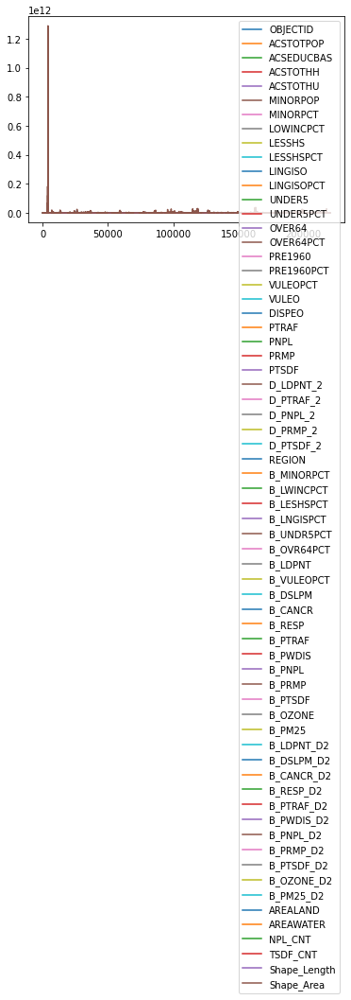

In [17]:
ej.plot()

In [18]:
blockgroups.head()

,n_persons_under_18,n_persons_over_60,n_persons_over_75,n_persons_over_15,n_married,n_widowed_divorced,n_total_families,n_female_headed_families,n_nonhisp_white_persons,n_nonhisp_black_persons,...,p_female_headed_families,p_nonhisp_white_persons,p_nonhisp_black_persons,p_hispanic_persons,p_native_persons,p_asian_persons,p_hawaiian_persons,p_asian_indian_persons,p_veterans,geometry
GEOID,,,,,,,,,,,,,,,,,,,,,
020130001003,287.0,213.0,26.0,1164.0,154.0,218.0,280.0,29.0,234.0,4.0,...,10.357143,16.846652,0.287977,6.839453,41.324694,23.182145,1.007919,23.182145,4.463643,"MULTIPOLYGON (((-159.91033 54.81417, -159.9057..."
020160001001,175.0,157.0,25.0,807.0,64.0,146.0,127.0,10.0,203.0,41.0,...,7.874016,20.949432,4.231166,11.764706,48.710010,9.907121,3.405573,9.907121,12.074303,"MULTIPOLYGON (((179.38874 51.94192, 179.40456 ..."
020160002001,320.0,224.0,21.0,1884.0,256.0,302.0,248.0,3.0,270.0,91.0,...,1.209677,12.517385,4.218822,12.888271,1.205378,66.759388,0.834492,66.759388,2.781641,"MULTIPOLYGON (((-167.24289 53.85467, -167.2370..."
020160002002,468.0,335.0,29.0,2220.0,304.0,435.0,341.0,6.0,916.0,114.0,...,1.759531,34.908537,4.344512,15.472561,5.182927,33.574695,3.696646,33.574695,3.620427,"MULTIPOLYGON (((-167.90386 53.22286, -167.8910..."
020200001011,75.0,79.0,37.0,404.0,49.0,73.0,63.0,0.0,351.0,4.0,...,0.000000,75.646552,0.862069,0.000000,12.715517,3.232759,0.000000,3.232759,9.482759,"MULTIPOLYGON (((-149.47075 61.45923, -149.4505..."


In [19]:
bg_geoms = blockgroups[['geometry']]

In [21]:
bg_geoms

,geometry
GEOID,
020130001003,"MULTIPOLYGON (((-159.91033 54.81417, -159.9057..."
020160001001,"MULTIPOLYGON (((179.38874 51.94192, 179.40456 ..."
020160002001,"MULTIPOLYGON (((-167.24289 53.85467, -167.2370..."
020160002002,"MULTIPOLYGON (((-167.90386 53.22286, -167.8910..."
020200001011,"MULTIPOLYGON (((-149.47075 61.45923, -149.4505..."
...,...
560419753004,"MULTIPOLYGON (((-110.95727 41.25777, -110.9572..."
560419753005,"MULTIPOLYGON (((-110.98205 41.21578, -110.9816..."
560419753006,"MULTIPOLYGON (((-111.04584 41.57985, -111.0454..."


In [19]:
geoms = gpd.read_parquet('s3://spatial-ucr/census/acs/acs_2018_bg.parquet', columns=['geometry'])

In [20]:
ejscreen = ejscreen.merge(bg_geoms, left_on="ID", right_index=True)

In [21]:
type(ejscreen)

pandas.core.frame.DataFrame

In [22]:
ejscreen.head()

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area,geometry
0,1,010010201001,636,636,418,294,294,104,0.163522,245,...,54%ile,9.69 ug/m3 (86%ile),52%ile,4259428.0,28435.0,0,0,13443.155206,6.040790e+06,"MULTIPOLYGON (((-86.51038 32.47225, -86.51031 ..."
1,2,010010201002,1287,1287,885,471,485,278,0.216006,210,...,36%ile,9.69 ug/m3 (86%ile),28%ile,5558385.0,0.0,0,0,11917.089598,7.834160e+06,"MULTIPOLYGON (((-86.50461 32.47723, -86.50453 ..."
2,3,010010202001,810,802,568,322,370,548,0.676543,402,...,70%ile,9.71 ug/m3 (86%ile),72%ile,2058380.0,0.0,0,0,7770.915121,2.900774e+06,"MULTIPOLYGON (((-86.48127 32.47744, -86.48126 ..."
3,4,010010202002,1218,1016,875,397,482,670,0.550082,400,...,67%ile,9.71 ug/m3 (86%ile),69%ile,1267299.0,5669.0,0,0,6506.804784,1.793332e+06,"MULTIPOLYGON (((-86.47611 32.46765, -86.47564 ..."
4,5,010010203001,2641,2641,1849,948,1049,899,0.340401,814,...,51%ile,9.75 ug/m3 (86%ile),48%ile,3866515.0,9054.0,0,0,11070.367848,5.461602e+06,"MULTIPOLYGON (((-86.47087 32.47573, -86.47084 ..."


In [26]:
ejscreen = gpd.GeoDataFrame(ejscreen)

In [28]:
type(ejscreen)

geopandas.geodataframe.GeoDataFrame

<AxesSubplot:>

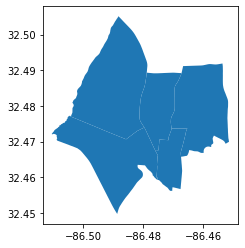

In [27]:
ejscreen.head().plot()

In [29]:
ejscreen.head()

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area,geometry
0,1,010010201001,636,636,418,294,294,104,0.163522,245,...,54%ile,9.69 ug/m3 (86%ile),52%ile,4259428.0,28435.0,0,0,13443.155206,6.040790e+06,"MULTIPOLYGON (((-86.51038 32.47225, -86.51031 ..."
1,2,010010201002,1287,1287,885,471,485,278,0.216006,210,...,36%ile,9.69 ug/m3 (86%ile),28%ile,5558385.0,0.0,0,0,11917.089598,7.834160e+06,"MULTIPOLYGON (((-86.50461 32.47723, -86.50453 ..."
2,3,010010202001,810,802,568,322,370,548,0.676543,402,...,70%ile,9.71 ug/m3 (86%ile),72%ile,2058380.0,0.0,0,0,7770.915121,2.900774e+06,"MULTIPOLYGON (((-86.48127 32.47744, -86.48126 ..."
3,4,010010202002,1218,1016,875,397,482,670,0.550082,400,...,67%ile,9.71 ug/m3 (86%ile),69%ile,1267299.0,5669.0,0,0,6506.804784,1.793332e+06,"MULTIPOLYGON (((-86.47611 32.46765, -86.47564 ..."
4,5,010010203001,2641,2641,1849,948,1049,899,0.340401,814,...,51%ile,9.75 ug/m3 (86%ile),48%ile,3866515.0,9054.0,0,0,11070.367848,5.461602e+06,"MULTIPOLYGON (((-86.47087 32.47573, -86.47084 ..."


In [30]:
tracts.head()

,n_mexican_pop,n_cuban_pop,n_puerto_rican_pop,n_russian_pop,n_italian_pop,n_german_pop,n_irish_pop,n_scandaniavian_pop,n_foreign_born_pop,n_recent_immigrant_pop,...,p_veterans,p_poverty_rate,p_poverty_rate_over_65,p_poverty_rate_children,p_poverty_rate_white,p_poverty_rate_black,p_poverty_rate_hispanic,p_poverty_rate_native,p_poverty_rate_asian,geometry
GEOID,,,,,,,,,,,,,,,,,,,,,
02020001300,83.0,9.0,0.0,10.0,13.0,177.0,73.0,0.0,178.0,49.0,...,6.715702,3.952057,0.000000,0.000000,3.952057,0.000000,1.068999,0.000000,0.000000,"MULTIPOLYGON (((-149.98205 61.22613, -149.9676..."
02020001400,182.0,0.0,123.0,2.0,17.0,249.0,45.0,45.0,871.0,296.0,...,7.132950,18.109294,0.039888,2.951735,3.749501,12.584763,0.518548,1.196649,0.000000,"MULTIPOLYGON (((-149.91326 61.19631, -149.9132..."
02020001500,206.0,0.0,0.0,14.0,44.0,99.0,90.0,34.0,744.0,383.0,...,7.089829,5.586802,0.712411,0.000000,3.355831,0.000000,0.806149,0.712411,0.000000,"MULTIPOLYGON (((-149.86817 61.19528, -149.8681..."
02020001601,254.0,0.0,22.0,0.0,8.0,134.0,76.0,0.0,481.0,100.0,...,4.066042,4.160363,0.579929,0.176500,1.487645,0.277358,0.403429,0.327786,0.554715,"MULTIPOLYGON (((-149.83828 61.20771, -149.8380..."
02020001602,173.0,0.0,2.0,14.0,0.0,185.0,113.0,7.0,388.0,95.0,...,10.044944,5.344089,0.504159,0.403327,1.890597,0.680615,0.000000,0.932695,0.000000,"MULTIPOLYGON (((-149.83826 61.19537, -149.8377..."


<AxesSubplot:>

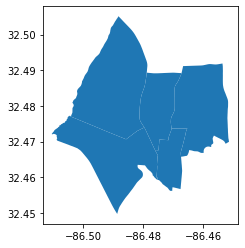

In [31]:
ejscreen.head().plot()

In [32]:
ej = gpd.GeoDataFrame(ej.merge(geoms, left_on='ID', right_index=True))

**Command Below: Creating variable for California's Environmental Justice**  
Selecting Data for California 


In [33]:
ca_ej = ej[ej.ID.str.startswith('06')]

### Command: Give me the number of rates regarding air toxics cancer risk in CA

In [34]:
(ca_ej.CANCER == "None").sum() 

36

In [35]:
CANCER = ca_ej.CANCER 

In [36]:
import numpy as np
ca_ej.CANCER = CANCER.replace(to_replace= "None", value=np.nan).astype(float)
# find out what is numpty 

/opt/tljh/user/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [40]:
ca_ej.head()

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area,geometry
10297,10298,060014001001,3115,3105,2455,1297,1362,1060,0.340289,312,...,24%ile,11.3 ug/m3 (94%ile),7%ile,6894340.0,0.0,0,0,18116.601501,1.108122e+07,"MULTIPOLYGON (((-122.24692 37.88544, -122.2466..."
10298,10299,060014002001,1037,1037,769,429,437,291,0.280617,81,...,44%ile,11.3 ug/m3 (94%ile),28%ile,288071.0,0.0,0,0,3776.257571,4.627947e+05,"MULTIPOLYGON (((-122.25508 37.84607, -122.2542..."
10299,10300,060014002002,988,981,810,426,426,298,0.301619,149,...,49%ile,11.3 ug/m3 (94%ile),37%ile,298490.0,0.0,0,0,4019.010837,4.794874e+05,"MULTIPOLYGON (((-122.25792 37.84261, -122.2577..."
10300,10301,060014003001,1137,1137,829,432,484,282,0.248021,41,...,39%ile,11.2 ug/m3 (94%ile),20%ile,265695.0,0.0,0,0,3231.259100,4.267776e+05,"MULTIPOLYGON (((-122.25186 37.84475, -122.2517..."
10301,10302,060014003002,1404,1366,1175,771,785,378,0.269231,172,...,41%ile,11.2 ug/m3 (94%ile),22%ile,269347.0,0.0,0,0,4482.836688,4.325698e+05,"MULTIPOLYGON (((-122.26231 37.83786, -122.2622..."


In [43]:
small = ca_ej[ca_ej.ID.str.startswith("06065")]

In [44]:
small.shape

(1030, 142)

In [42]:
ca_ej.shape

(23212, 142)

## Cancer variable= Air toxics cancer risk 

In [45]:
pip install git+https://github.com/martinfleis/geopandas-view.git

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/martinfleis/geopandas-view.git to /tmp/pip-req-build-vi_lsc4_
  Running command git clone -q https://github.com/martinfleis/geopandas-view.git /tmp/pip-req-build-vi_lsc4_
Note: you may need to restart the kernel to use updated packages.


In [47]:
from geopandas_view import view

In [50]:
# subset for riverside county 
view(small, column='CANCER', scheme='quantiles', tooltip=['T_CANCR'])

In [49]:
# subset for riverside county 
view(small, column='MINORPCT', scheme='quantiles', tooltip=['MINORPCT'])


In [32]:
import quilt3
b = quilt3.Bucket("s3://spatial-ucr")

In [33]:
import pandas as pd 

In [43]:
epa = pd.read_parquet('ejscreen_2020.parquet')                    

In [44]:
epa.head()

,OBJECTID,ID,ACSTOTPOP,ACSIPOVBAS,ACSEDUCBAS,ACSTOTHH,ACSTOTHU,MINORPOP,MINORPCT,LOWINCOME,...,T_OZONE,T_OZONE_D2,T_PM25,T_PM25_D2,AREALAND,AREAWATER,NPL_CNT,TSDF_CNT,Shape_Length,Shape_Area
0,1,010010201001,636,636,418,294,294,104,0.163522,245,...,36.8 ppb (15%ile),54%ile,9.69 ug/m3 (86%ile),52%ile,4259428.0,28435.0,0,0,13443.155206,6.040790e+06
1,2,010010201002,1287,1287,885,471,485,278,0.216006,210,...,36.8 ppb (15%ile),36%ile,9.69 ug/m3 (86%ile),28%ile,5558385.0,0.0,0,0,11917.089598,7.834160e+06
2,3,010010202001,810,802,568,322,370,548,0.676543,402,...,36.8 ppb (16%ile),70%ile,9.71 ug/m3 (86%ile),72%ile,2058380.0,0.0,0,0,7770.915121,2.900774e+06
3,4,010010202002,1218,1016,875,397,482,670,0.550082,400,...,36.8 ppb (16%ile),67%ile,9.71 ug/m3 (86%ile),69%ile,1267299.0,5669.0,0,0,6506.804784,1.793332e+06
4,5,010010203001,2641,2641,1849,948,1049,899,0.340401,814,...,36.9 ppb (16%ile),51%ile,9.75 ug/m3 (86%ile),48%ile,3866515.0,9054.0,0,0,11070.367848,5.461602e+06


In [45]:
import quilt3
b =quilt3.Bucket

Tasks: 
1. Find out what the no number means 
2. Needs Block Group Spatial ACS group Data 
3. Decide what variables you want to do 

--- 
Advice: 
1. Rather than saying zero then you can do a midrange 
If it si a count then maybe Nonum should be zero 
If it is a rate (percentage), then zero probably would not be a good idea 
Sometimes you do spatial merge- it depends on the research question. 
